# <img style="float: left; padding-right: 10px; width: 150px" src="../_UNITBV_ADS_2019/unitbv2.png"> SIIPA2020- Știința Explorării și Exploatării Datelor - ADS1  






## <center>Curs 6 - Vizualizare Datelor: exemple</center>
**Universitatea Transilvania**<br>
**Semestrul I, 2020-2021**<br>
**Instructor:** Conf. univ. dr. Teodor &Scedil;tefan B&icirc;ldea<br>
**Contact:** teodor.bildea@unitbv.ro<br>


Instructiuni:
    
    - downloadati o copie a acestui notebook de pe google drive
    _ downloadati tot folderul cu datele proiectelor local pe C:\temp\
    - upload in jupyter 
    - schimbati numele fisierului adaugand la sfarsit numele vostru
    - urmati indicatiile din notebook si completati exercitiile
    
    
> SFAT: pentru toate exercitiile se poate folosi internetul pentru solutie daca este nevoie - stackoverflow este plin de oameni dornici sa ajute si care probabil au raspuns deja altora ca voi care au inceput sa invete Python mai devreme.

In [2]:
# Instalare pachet/ udpdate pachet plotly

In [ ]:
# daca nu ati instalat plotly...
!pip install plotly

Import librarii necesare

In [3]:
import pandas as pd
import numpy as np
import sqlite3

## Recapitulare si completari

### Alte moduri de selectare a unei submultimi din dataframe:

> .loc: access la inregistrari cu specificarea valorilor cautate sau a unui sablon boolean

> .iloc: access prin precizarea numarului liniei si/sau a coloanei

## .loc

### Exemplu:

Dupa cum vedeti s-a strecurat un tipo - `Uncofirmed` care a dus la aparitia unei categorii noi, in mod eronat. Editati eroarea si coretati-o cu `Unconfirmed` selectand coloana si conditionand ca valoarea sa fie cea incorecta, si atribuind acestor inregistrari valoarea corecta

In [4]:
file_name = 'monitor_one_daily_output.csv'

# citire fisierului - 'df' de la dataframe, si un nume de variabila:
df_sample_csv = pd.read_csv ( file_name)

# verificam primele linii invocand functia head:
df_sample_csv.Belief.drop_duplicates()

0                   Weak
1             Uncofirmed
11    Strong but overdue
20           Unconfirmed
49                Strong
Name: Belief, dtype: object

În acest exemplu voi folosi un șablon boolean, de condiționare a liniilor.
După virgula se pot selecta coloanele dorite.

Când se selectează o singura coloană, nu e nevoie de lista.

In [5]:
df_sample_csv.loc[ df_sample_csv['Belief'] == 'Uncofirmed','Belief'].shape[0]

49

In [6]:
df_sample_csv.shape

(151, 10)

În toate înregistrările cu typo corectăm valoare din coloana <b>Belief</b>:

In [7]:
df_sample_csv.loc[ df_sample_csv['Belief'] == 'Uncofirmed','Belief'] = 'Unconfirmed'

In [8]:
df_sample_csv[ df_sample_csv['Belief'] == 'Uncofirmed'].shape

(0, 10)

Alte exemple de selectare cu .loc

In [9]:
df_sample_csv.loc[0:10,['Likelihood_Score','Belief']]

,Likelihood_Score,Belief
0,92.703030,Weak
1,79.393106,Unconfirmed
2,90.546950,Unconfirmed
3,99.561564,Unconfirmed
4,100.000000,Unconfirmed
5,99.733736,Unconfirmed
6,99.911712,Unconfirmed
7,74.836137,Unconfirmed
8,99.941313,Unconfirmed
9,99.790908,Unconfirmed


## .iloc

Selectare pe baza de numarul de linie si de coloana. 

Se pot folosi intervale de linii si coloane. 

Prima data se precizeaza liniile, urmate de virgula si precizarea coloanelor.

### Exemple:

Prima linie, a doua coloana (indexul pozitional porneste de la 0!)

In [10]:
df_sample_csv.iloc[5,1]

'2/15/2019'

O lista de linii si alta de coloane

In [11]:
df_sample_csv.iloc[[0,7,9,3],[1,2,5]]

,date_only,Daily_Outcome,Over Heat Event
0,2/24/2019,Overheat in more than 14 days,NaN
7,2/11/2019,Overheat in less than 7 days,NaN
9,1/24/2019,Overheat in less than 7 days,1/24/2019 10:51
3,2/20/2019,Overheat in more than 14 days,NaN


Atat pentru linii cat si pentru coloane se pot preciza de valori de tip `<inceput>:<sfarsit>` dupa cum urmeaza:

- selectam a opta inregistrare si coloanele 2,3,4:

In [12]:
df_sample_csv.iloc[7,2:4]

Daily_Outcome        Overheat in less than 7 days
Daily_Outcome_Idx                               0
Name: 7, dtype: object

- primele opt inregistrari si coloanele 2,3,4

In [13]:
df_sample_csv.columns

Index(['car', 'date_only', 'Daily_Outcome', 'Daily_Outcome_Idx',
       'Likelihood_Score', 'Over Heat Event', 'rows_per_car_day', 'Belief',
       'Action_level', 'Notes'],
      dtype='object')

In [14]:
df_sample_csv.iloc[0:7,2:5]

,Daily_Outcome,Daily_Outcome_Idx,Likelihood_Score
0,Overheat in more than 14 days,2,92.703030
1,"Overheat in [7, 14] days",1,79.393106
2,Overheat in less than 7 days,0,90.546950
3,Overheat in more than 14 days,2,99.561564
4,Overheat in more than 14 days,2,100.000000
5,"Overheat in [7, 14] days",1,99.733736
6,Overheat in less than 7 days,0,99.911712


- ceva mai exotic: toate coloanele impare cu ajutorul unei expresii `lambda`

In [15]:
df_sample_csv.iloc[ lambda x: x.index % 2 == 0, [0,1,3]]

,car,date_only,Daily_Outcome_Idx
0,2221138,2/24/2019,2
2,2221138,2/22/2019,0
4,2221138,2/19/2019,2
6,2221138,2/12/2019,0
8,2221138,2/6/2019,0
...,...,...,...
142,2221251,12/13/2018,0
144,2221251,12/11/2018,0
146,2221251,12/9/2018,0
148,2221251,12/7/2018,0


# Vizualizare datelor

## Date numerice, date categoriale

> bar graph, box plot, line graph, scatter plot, etc.

Mi-am propus zece grafice, cate unul pentru fiecare proiect.

Voi trece in revista 3 pachete de functii grafice:

In [16]:
import matplotlib.pyplot as plt

import seaborn as sns # visualize

import plotly.express as px


## CONFIGURARE CITIRE

## Intermezzo tehnic pentru a putea sa ma asigur ca pot citi datele

In urmatoarele 2 celule testez codul pentru citirea datelor

In [17]:
import  glob
p =  r'C:\work\UNITBV_DataMining\2020-2021\SEED_ADS\Curs\Echipe\DateProiecte\Echipa'

#listarea numelor de fisiere din calea p care sunt te tip csvȘ
result = glob.glob( p + '1/' + '*.csv' )
result

['C:\\work\\UNITBV_DataMining\\2020-2021\\SEED_ADS\\Curs\\Echipe\\DateProiecte\\Echipa1\\audi.csv',
 'C:\\work\\UNITBV_DataMining\\2020-2021\\SEED_ADS\\Curs\\Echipe\\DateProiecte\\Echipa1\\bmw.csv',
 'C:\\work\\UNITBV_DataMining\\2020-2021\\SEED_ADS\\Curs\\Echipe\\DateProiecte\\Echipa1\\cclass.csv',
 'C:\\work\\UNITBV_DataMining\\2020-2021\\SEED_ADS\\Curs\\Echipe\\DateProiecte\\Echipa1\\focus.csv',
 'C:\\work\\UNITBV_DataMining\\2020-2021\\SEED_ADS\\Curs\\Echipe\\DateProiecte\\Echipa1\\ford.csv',
 'C:\\work\\UNITBV_DataMining\\2020-2021\\SEED_ADS\\Curs\\Echipe\\DateProiecte\\Echipa1\\hyundi.csv',
 'C:\\work\\UNITBV_DataMining\\2020-2021\\SEED_ADS\\Curs\\Echipe\\DateProiecte\\Echipa1\\merc.csv',
 'C:\\work\\UNITBV_DataMining\\2020-2021\\SEED_ADS\\Curs\\Echipe\\DateProiecte\\Echipa1\\skoda.csv',
 'C:\\work\\UNITBV_DataMining\\2020-2021\\SEED_ADS\\Curs\\Echipe\\DateProiecte\\Echipa1\\toyota.csv',
 'C:\\work\\UNITBV_DataMining\\2020-2021\\SEED_ADS\\Curs\\Echipe\\DateProiecte\\Echipa1\\uncl

In [18]:
# citirea datelor
import os
import glob

input_path = r'C:\work\UNITBV_DataMining\2020-2021\SEED_ADS\Curs\Echipe\DateProiecte\Echipa'
#C:/temp/ProjectDataSets
files = {'echipa1':{'cale':'1',
                    'tip':'csv',
                     'fisiere':glob.glob( input_path + '1/' + '*.csv' )
                    },
            'echipa2':{'cale':'2',
                       'tip':'csv',
                     'fisiere':glob.glob( input_path + '2/' + '*.csv' )
                    },
            'echipa3':{'cale':'3',
                       'tip':'csv',
                     'fisiere':glob.glob( input_path + '3/' + '*.csv' )
                    },
            'echipa4':{'cale':'4',
                       'tip':'csv',
                     'fisiere':glob.glob( input_path + '4/' + '*csv' )
                    },
            'echipa5':{'cale':'5',
                       'tip':'xlsx',
                     'fisiere':glob.glob( input_path + '5/' + '*.xlsx' )
                    },
            'echipa6':{'cale':'6',
                       'tip':'sqlite',
                     'fisiere':glob.glob( input_path + '6/' + '*.sqlite' )
                    },
            'echipa7':{'cale':'7',
                       'tip':'csv',
                       'fisiere':glob.glob( input_path + '7/' + '*.csv' )+glob.glob( input_path + '7/' + '*.json' ),
#             'echipat7.II':{'cale':'7',
#                        'tip':'json',
#                        'fisiere':glob.glob( input_path + '7/' + '*.json' )
                       
                    },
            'echipa8':{'cale':'8',
                       'tip':'csv',
                     'fisiere':glob.glob( input_path + '8/' + '*.csv' )
                    },
            'echipa9':{'cale':'9',
                       'tip':'xlsx',
                     'fisiere':glob.glob( input_path + '9/' + '*.xlsx' )
                    }
            
        }

In [19]:
glob.glob( input_path + '7/' + '*.csv' )+glob.glob( input_path + '7/' + '*.json' )

['C:\\work\\UNITBV_DataMining\\2020-2021\\SEED_ADS\\Curs\\Echipe\\DateProiecte\\Echipa7\\winemag-data-130k-v2.csv',
 'C:\\work\\UNITBV_DataMining\\2020-2021\\SEED_ADS\\Curs\\Echipe\\DateProiecte\\Echipa7\\winemag-data_first150k.csv',
 'C:\\work\\UNITBV_DataMining\\2020-2021\\SEED_ADS\\Curs\\Echipe\\DateProiecte\\Echipa7\\winemag-data-130k-v2.json']

In [20]:
def citire_date_echipa(nume_echipa):
    
    team_dfs ={}
    
    team = nume_echipa
    print('citire pt ', team)
    dataset = files[team]
#    try:
        
    

    dataframes = []
    
    i=0
    n = len(dataset['fisiere'])
    for f in dataset['fisiere']:
        
        i+=1
        print('{0} out of {1}: {2}'.format(str(i),str(n), f))
        try:

            # extensia fisierului 
            extension = f.split('.')[-1]

            if extension == 'csv':
                # citire fisier csv
                df_temp = pd.read_csv(f,header = 0)

            elif extension == 'xlsx':
                df_temp = pd.read_excel(f, header = 0)
                
            elif extension == 'json':
                df_temp = pd.read_json(f,orient='records')

            elif extension == 'sqlite':    
                conn = sqlite3.connect( f)

                # numele tabelelor
                df_tables = pd.read_sql_query("SELECT name FROM sqlite_master WHERE type='table' ORDER BY name;", conn)
                print(df_tables)
                #dataframes = []
                n = len(list(df_tables.name.values))
                for i in range(n):

                    t = df_tables.name.values[i]
                    print('extragere date tabel {0} ({1} out of {2})'.format( t,str(i),str(n)))
                    
                    try:
                        df_temp = pd.read_sql_query("SELECT * FROM " + t, conn)

                        dataframes.append(df_temp)
                        # eliberarea memoriei
                        del df_temp
                    except:
                        print("eroare la citirea tabele {0} ({1} out of {2})".format( t,str(i),str(n)))

            if extension != 'sqlite': 
                # adaugare dataframe la colectia de dataframe-uri
                dataframes.append(df_temp)
            # eliberarea memoriei
            del df_temp
        except:
            print('eroare la citire fisierelor pt ', team, 'fisier ', f)

    team_dfs[team] = dataframes

    print('echipa ', team, ' are ', len(team_dfs[team]), 'dataframe-uri.')

    return team_dfs

## Exemplul 1. Echipa 9

### Line plots

In [21]:
date_echipa = citire_date_echipa('echipa9')['echipa9']


citire pt  echipa9
1 out of 1: C:\work\UNITBV_DataMining\2020-2021\SEED_ADS\Curs\Echipe\DateProiecte\Echipa9\Predict Sales.xlsx
echipa  echipa9  are  1 dataframe-uri.


In [22]:
date_echipa[0].columns


Index(['OrderDate', 'GMV', 'Units', 'PaymentType', 'SLA', 'Category',
       'MarkedPrice', 'SLA.1'],
      dtype='object')

In [23]:
date_echipa[0].tail(5)

,OrderDate,GMV,Units,PaymentType,SLA,Category,MarkedPrice,SLA.1
1048570,2015-09-22 17:17:00,490,1,COD,8,EntertainmentSmall,999,5
1048571,2015-09-22 11:26:00,419,1,Prepaid,9,EntertainmentSmall,349,5
1048572,2015-09-15 13:06:00,284,1,Prepaid,5,GamingHardware,410,1
1048573,2015-09-14 16:06:00,299,1,COD,8,EntertainmentSmall,999,1
1048574,2015-08-30 13:17:00,285,1,COD,16,CameraAccessory,395,3


Ar fi interesant sa vedem volumul lunar al vanzarilor. Pentru asta vom construi doua noi coloane

> ItemRevenue

> InvoiceMonth - asta va da un exemplu de formatare a datelor in Python

In [24]:
date_echipa[0]['Revenue'] = date_echipa[0]['Units'] * \
                            date_echipa[0]['MarkedPrice']


Un mod eficace de a trece din format `datetime` in str:

In [25]:
from datetime import datetime
date_echipa[0]['InvoiceMonth'] = date_echipa[0]['OrderDate'].\
apply(lambda x: str(x.year) + '-'+ ( '0' if x.month <10 else '') + str(x.month))

In [26]:
date_echipa[0].head()

,OrderDate,GMV,Units,PaymentType,SLA,Category,MarkedPrice,SLA.1,Revenue,InvoiceMonth
0,2016-06-11 11:52:00,607,1,Prepaid,6,CameraAccessory,1339,3,1339,2016-06
1,2016-05-31 18:48:00,413,1,COD,15,CameraAccessory,848,2,848,2016-05
2,2016-05-30 17:51:00,378,1,Prepaid,9,CameraAccessory,848,2,848,2016-05
3,2016-05-30 17:51:00,664,1,COD,6,CameraAccessory,1448,4,1448,2016-05
4,2016-05-28 22:27:00,372,1,Prepaid,6,GamingHardware,348,3,348,2016-05


In [27]:
# sa vedem volumul lunar de vanzari

df_sample = date_echipa[0].groupby('InvoiceMonth')['Revenue'].agg('sum').reset_index()
df_sample.head(5)

,InvoiceMonth,Revenue
0,2015-08,395
1,2015-09,97187
2,2015-10,930409911
3,2015-11,546207198
4,2015-12,746291693


Ca si cu toate celelalte, vizualizarea depinde de libraria folosita:

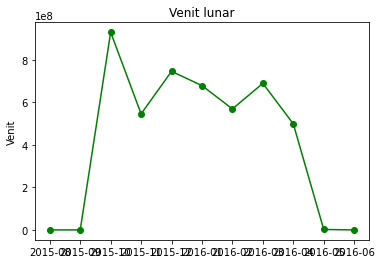

In [28]:

# create a line chart, years on x-axis, gdp on y-axis
plt.plot(df_sample.InvoiceMonth, df_sample.Revenue, 
         color='green', marker='o', linestyle='solid')
# add a title
plt.title("Venit lunar")
# add a label to the y-axis
plt.ylabel("Venit")
plt.show()

Dupa cum vedem, etichetele lunilor sunt suprascrise. Pentru a evita acest aspect putem roti etichetele.

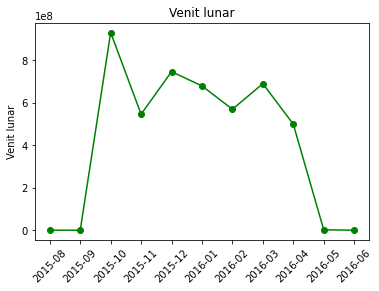

In [29]:
plt.plot(df_sample.InvoiceMonth, df_sample.Revenue, color='green', marker='o', linestyle='solid')
# add a title
plt.title("Venit lunar")
# add a label to the y-axis
plt.ylabel("Venit lunar")
plt.xticks(range(df_sample.shape[0]), df_sample.InvoiceMonth, rotation=45)
plt.show()

### Acum sa vedem acelasi grafic cu seaborn


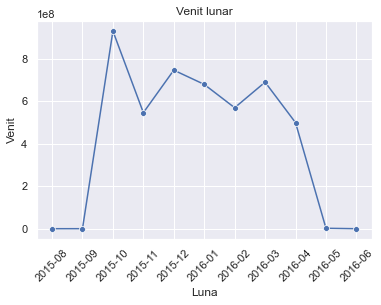

In [30]:
sns.set() #Seteza parameterii estetici intr-un singur pas. Puteti explora cu stiluri

ax = sns.lineplot(x="InvoiceMonth", y="Revenue", data=df_sample, marker='o')
ax.set_title('Venit lunar')
ax.set_ylabel("Venit")
ax.set_xlabel("Luna")
ax.set_xticklabels(df_sample.InvoiceMonth, rotation = 45)
plt.show()

### Acelasi grafic cu pachetul plotly

In [31]:
# import plotly.express as px

df = df_sample

import plotly.graph_objects as go

fig = go.Figure(data=go.Scatter(x=df.InvoiceMonth, y=df.Revenue))
fig.show()

## EXERCITIUL 1:

1. Determinati cea mai bine vanduta categorie de produse
2. Prezentati graficul de venit lunar pentru acea categorie de produse

In [32]:
# codul vostru aici


# Exemplul 2. Echipa 2

## Bar Charts

Un grafic de bare este o alegere bună atunci când doriți să arătați cum variază o anumită cantitate într-un un set de elemente discrete.

In [40]:
date_echipa = citire_date_echipa('echipa2')['echipa2']

citire pt  echipa2
1 out of 4: C:\work\UNITBV_DataMining\2020-2021\SEED_ADS\Curs\Echipe\DateProiecte\Echipa2\sample_sub.csv
2 out of 4: C:\work\UNITBV_DataMining\2020-2021\SEED_ADS\Curs\Echipe\DateProiecte\Echipa2\test_data.csv
3 out of 4: C:\work\UNITBV_DataMining\2020-2021\SEED_ADS\Curs\Echipe\DateProiecte\Echipa2\train_data.csv
4 out of 4: C:\work\UNITBV_DataMining\2020-2021\SEED_ADS\Curs\Echipe\DateProiecte\Echipa2\train_data_dictionary.csv
echipa  echipa2  are  4 dataframe-uri.


In [41]:
date_echipa[2].head()

,case_id,Hospital_code,Hospital_type_code,City_Code_Hospital,Hospital_region_code,Available Extra Rooms in Hospital,Department,Ward_Type,Ward_Facility_Code,Bed Grade,patientid,City_Code_Patient,Type of Admission,Severity of Illness,Visitors with Patient,Age,Admission_Deposit,Stay
0,1,8,c,3,Z,3,radiotherapy,R,F,2.0,31397,7.0,Emergency,Extreme,2,51-60,4911.0,0-10
1,2,2,c,5,Z,2,radiotherapy,S,F,2.0,31397,7.0,Trauma,Extreme,2,51-60,5954.0,41-50
2,3,10,e,1,X,2,anesthesia,S,E,2.0,31397,7.0,Trauma,Extreme,2,51-60,4745.0,31-40
3,4,26,b,2,Y,2,radiotherapy,R,D,2.0,31397,7.0,Trauma,Extreme,2,51-60,7272.0,41-50
4,5,26,b,2,Y,2,radiotherapy,S,D,2.0,31397,7.0,Trauma,Extreme,2,51-60,5558.0,41-50


In [44]:
df_sample = date_echipa[2]
df_sample.columns

Index(['case_id', 'Hospital_code', 'Hospital_type_code', 'City_Code_Hospital',
       'Hospital_region_code', 'Available Extra Rooms in Hospital',
       'Department', 'Ward_Type', 'Ward_Facility_Code', 'Bed Grade',
       'patientid', 'City_Code_Patient', 'Type of Admission',
       'Severity of Illness', 'Visitors with Patient', 'Age',
       'Admission_Deposit', 'Stay'],
      dtype='object')

In [45]:
df_sample.loc[ df_sample['Stay']=='More than 100 Days','Stay' ] = '>100 days'

Sa vedem distributia clientilor in functie de pachetul de internet:

"A count plot can be thought of as a histogram across a categorical, instead of quantitative, variable. "

Text(0.5, 1.0, 'Cases by Stay')

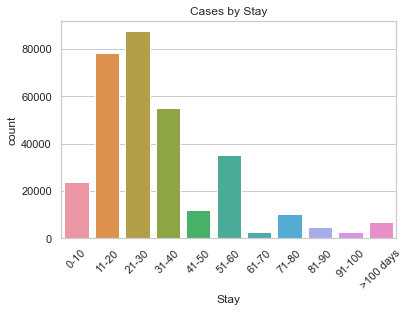

In [47]:
df_sample = date_echipa[2].sort_values(by = 'Stay')
sns.set(style="whitegrid")
ax = sns.countplot(x="Stay", data=df_sample)

# rotim etichetele - observati ca la primul parametri invocam metoda care la randul ei invoca etichetele setate deja
ax.set_xticklabels(ax.get_xticklabels(), rotation = 45)

ax.set_title('Cases by Stay')

### Seaborn countplot cu grupare (hue)


In [48]:
# incercam sa transformam Severity of Illnes
df_sample["SOI_1char"] = df_sample["Severity of Illness"].apply(lambda x: "X" if x =='Extreme' else "M" if x == "Medium" else "R") 
df_sample

,case_id,Hospital_code,Hospital_type_code,City_Code_Hospital,Hospital_region_code,Available Extra Rooms in Hospital,Department,Ward_Type,Ward_Facility_Code,Bed Grade,patientid,City_Code_Patient,Type of Admission,Severity of Illness,Visitors with Patient,Age,Admission_Deposit,Stay,SOI_1char
0,1,8,c,3,Z,3,radiotherapy,R,F,2.0,31397,7.0,Emergency,Extreme,2,51-60,4911.0,0-10,X
136814,136815,28,b,11,X,2,gynecology,R,F,3.0,112307,1.0,Emergency,Moderate,2,21-30,4517.0,0-10,R
136815,136816,29,a,4,X,3,gynecology,S,F,3.0,112307,1.0,Emergency,Moderate,2,21-30,3846.0,0-10,R
136823,136824,11,b,2,Y,4,gynecology,Q,D,4.0,64198,14.0,Emergency,Moderate,2,21-30,5183.0,0-10,R
136837,136838,14,a,1,X,3,gynecology,R,E,3.0,76865,1.0,Emergency,Extreme,3,51-60,3452.0,0-10,X
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
68359,68360,10,e,1,X,2,gynecology,S,E,3.0,113737,8.0,Trauma,Moderate,6,61-70,4345.0,>100 days,R
15335,15336,18,d,13,Y,2,gynecology,R,B,3.0,17210,8.0,Trauma,Moderate,8,71-80,4413.0,>100 days,R
15334,15335,18,d,13,Y,2,gynecology,R,B,3.0,17210,8.0,Trauma,Moderate,8,71-80,3080.0,>100 days,R
31499,31500,26,b,2,Y,2,gynecology,Q,D,3.0,79939,5.0,Trauma,Moderate,20,51-60,5087.0,>100 days,R


Daca in loc de count dorim sa agregam pe axa y o alta variabila numerica vom folosi

`seaborn.barplot`

De exemplu sa vedem numarul <b>mediu</b> al vizitatorilor in functie de gravitatea bolii:

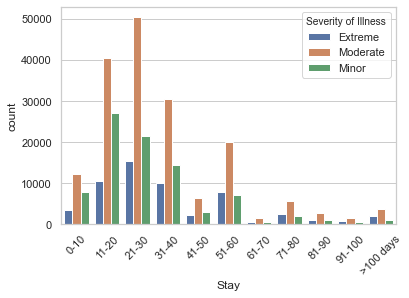

In [57]:
df_sample = date_echipa[2].sort_values(by = 'Stay')
ax = sns.countplot( x= "Stay",  
                 hue = df_sample['Severity of Illness'], 
                 data = df_sample)

# aici punct si virugla e folosita pentru a suprima textul printat deasupra graficului - incercati sa stergeti punct
# si virgula si rerulati
ax.set_xticklabels(ax.get_xticklabels(), rotation = 45);

### Barplot in Searborn

"It is also important to keep in mind that a bar plot shows only the mean (or other estimator) value, but in many cases it may be more informative to show the distribution of values at each level of the categorical variables. In that case, other approaches such as a box or violin plot may be more appropriate."

In medie cei mai multi vizitatori sunt pentru cazurile extreme.

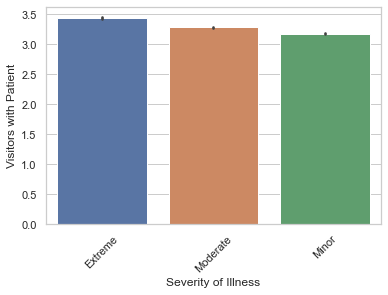

In [61]:
df_sample = date_echipa[2].sort_values(by = 'Stay')
ax = sns.barplot( x= "Severity of Illness",  y = "Visitors with Patient",
                 data = df_sample)

ax.set_xticklabels(ax.get_xticklabels(), rotation = 45);

In [187]:
df_sample.groupby("Severity of Illness")[ "Visitors with Patient"].agg("sum").reset_index()

,Severity of Illness,Visitors with Patient
0,Extreme,195128
1,Minor,273246
2,Moderate,577408


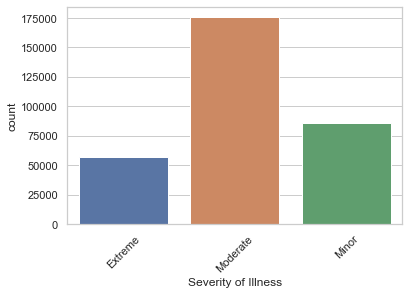

In [60]:
df_sample = date_echipa[2].sort_values(by = 'Stay')
ax = sns.countplot( x= "Severity of Illness",  
                 data = df_sample)

# aici punct si virugla e folosita pentru a suprima textul printat deasupra graficului - incercati sa stergeti punct
# si virgula si rerulati
ax.set_xticklabels(ax.get_xticklabels(), rotation = 45);

Observam in graficul anterior un parametru nou `hue` in functite de care se pot face grupari. 

In cazul nostru puteam sa calculam si vechimea medie a celor care pleaca indiferent de sex. 

Distinctia prin hue poate face mai relevanta informatia. 

Acest parametru se poate folosi in mai toate graficele seaborn.

Mai jos inca un exemplu cu x si hue interschimbate.

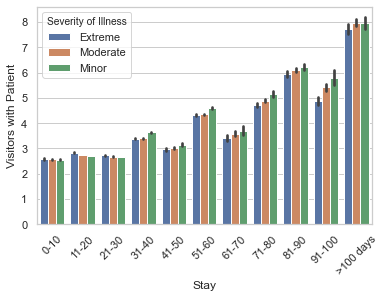

In [64]:
ax = sns.barplot( x = "Stay",y= "Visitors with Patient",  hue = "Severity of Illness", data = df_sample)
ax.set_xticklabels(ax.get_xticklabels(), rotation = 45);

In [79]:
## Ultimul grafic in plotly 
df_sample_agg = df_sample.groupby(['Stay','Severity of Illness'])['Visitors with Patient'].agg('mean').reset_index()
import plotly.express as px
df = df_sample_agg
fig = px.bar(df, x="Stay", y="Visitors with Patient", color='Severity of Illness')
fig.update_layout(barmode='group')
fig.show()



### Exercitiul 2
Refacti ultimul grafic in plotly cu suma vizitatorilor in loc de medie.


Folosind date_echipa[2] plotati un grafic barplot cu media Admission_Deposit - suma platita la admiterea in spital, pe categorii de Stay. Atentie, media e automat prezentateat in cazul barplot!

Apoi faceti acelasi grafic dar introduceti gruparea (cu hue respectiv color)  pe Type of Admission.

In [ ]:
# codul vostru aici

# Exemplul 3 - Echipa 2

## Histogram

Histogramele sunt o prezentare aproximativa a densitatii de distributie a unei variabile continue.

In [80]:
date_echipa = citire_date_echipa('echipa3')['echipa3']


citire pt  echipa3
1 out of 1: C:\work\UNITBV_DataMining\2020-2021\SEED_ADS\Curs\Echipe\DateProiecte\Echipa3\weatherHistory.csv
echipa  echipa3  are  1 dataframe-uri.


In [82]:
date_echipa[0].dtypes

Formatted Date               object
Summary                      object
Precip Type                  object
Temperature (C)             float64
Apparent Temperature (C)    float64
Humidity                    float64
Wind Speed (km/h)           float64
Wind Bearing (degrees)      float64
Visibility (km)             float64
Loud Cover                  float64
Pressure (millibars)        float64
Daily Summary                object
dtype: object

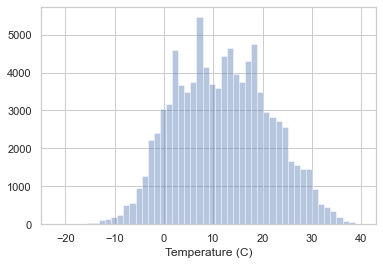

In [84]:
sns.distplot(date_echipa[0]['Temperature (C)'], bins=50, kde=False, rug=False)

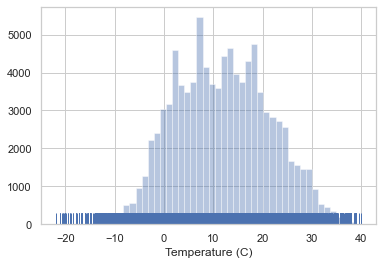

In [85]:
sns.distplot(date_echipa[0]['Temperature (C)'], bins=50, kde=False, rug=True)

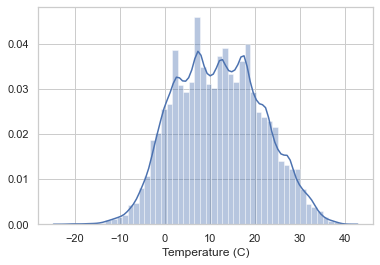

In [86]:
sns.distplot(date_echipa[0]['Temperature (C)'], bins=50, kde=True, rug=False)

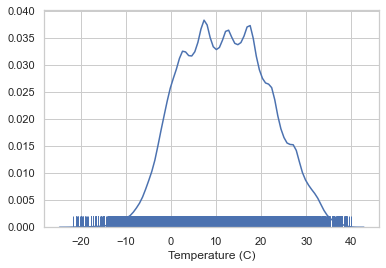

In [87]:
sns.distplot(date_echipa[0]['Temperature (C)'], bins=50, hist = False, kde=True, rug=True)

Sa vedem influenta numarului de bare (bins) folosit:

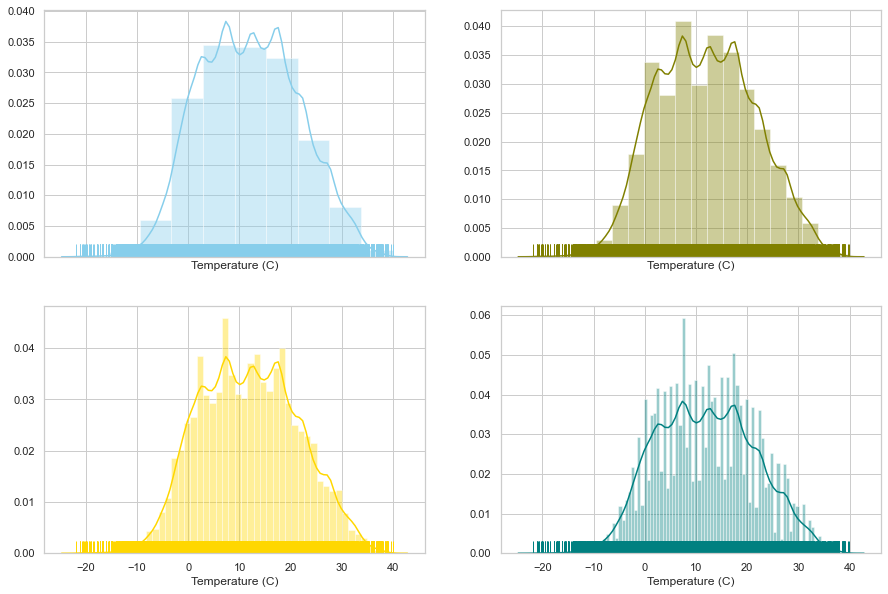

In [88]:
f, axes = plt.subplots(2, 2, figsize=(15, 10), sharex=True)

x = date_echipa[0]['Temperature (C)']
sns.distplot( x, bins=10, kde=True, rug=True, color="skyblue", ax=axes[0, 0])
sns.distplot( x, bins=20, kde=True, rug=True , color="olive", ax=axes[0, 1])
sns.distplot( x, bins=50, kde=True, rug=True , color="gold", ax=axes[1, 0])
sns.distplot( x, bins=100, kde=True, rug=True , color="teal", ax=axes[1, 1])

#sns.plt.show()

Doua distributii in acelasi plot:

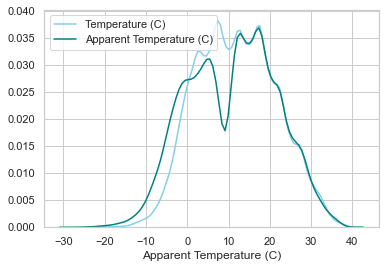

In [91]:
sns.distplot( date_echipa[0]['Temperature (C)'], bins=10, hist=False,kde=True, rug=False, 
             color="skyblue", label = "Temperature (C)")
sns.distplot( date_echipa[0]['Apparent Temperature (C)'], bins=10, hist = False, kde=True, rug=False , 
             color="teal", label = "Apparent Temperature (C)")
plt.legend()

## Exercitiul 3

1. Pe acelasi grafic reprezentati distributia umiditatii si a vizibilitatii.


In [92]:
# codul vostru aici

2. In doua grafice alaturate reprezentati distributia directie (wind bearing) respectiv a vitezei (wind speed) vantului

In [ ]:
# codul vostru aici

# Exemplul 4

## Pie charts

In [93]:
date_echipa = citire_date_echipa('echipa4')['echipa4']

citire pt  echipa4
1 out of 3: C:\work\UNITBV_DataMining\2020-2021\SEED_ADS\Curs\Echipe\DateProiecte\Echipa4\application_data.csv
2 out of 3: C:\work\UNITBV_DataMining\2020-2021\SEED_ADS\Curs\Echipe\DateProiecte\Echipa4\columns_description.csv
3 out of 3: C:\work\UNITBV_DataMining\2020-2021\SEED_ADS\Curs\Echipe\DateProiecte\Echipa4\previous_application.csv
echipa  echipa4  are  3 dataframe-uri.


In [94]:
date_echipa[0].head(5)

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


In [98]:
date_echipa[0].columns[0:20]

Index(['SK_ID_CURR', 'TARGET', 'NAME_CONTRACT_TYPE', 'CODE_GENDER',
       'FLAG_OWN_CAR', 'FLAG_OWN_REALTY', 'CNT_CHILDREN', 'AMT_INCOME_TOTAL',
       'AMT_CREDIT', 'AMT_ANNUITY', 'AMT_GOODS_PRICE', 'NAME_TYPE_SUITE',
       'NAME_INCOME_TYPE', 'NAME_EDUCATION_TYPE', 'NAME_FAMILY_STATUS',
       'NAME_HOUSING_TYPE', 'REGION_POPULATION_RELATIVE', 'DAYS_BIRTH',
       'DAYS_EMPLOYED', 'DAYS_REGISTRATION'],
      dtype='object')

Un alt mod de a prezenta agregari de categorii, la nivel de proportii, este pie chart: feliile de pizza/placinta.

Sa vedem proportia creditelor alocate pe tipurile de ocupatie precum si defaultul pe grupe.

Vom face un pie chart pentru proportii; vom colora specific grupului si vom eticheta cu tipurile de ocupatie.

In [99]:
df_sample = date_echipa[0].groupby('NAME_EDUCATION_TYPE')['TARGET'].agg(['count','mean']).reset_index()
df_sample

,NAME_EDUCATION_TYPE,count,mean
0,Academic degree,164,0.018293
1,Higher education,74863,0.053551
2,Incomplete higher,10277,0.084850
3,Lower secondary,3816,0.109277
4,Secondary / secondary special,218391,0.089399


In [100]:
df_sample.dtypes

NAME_EDUCATION_TYPE     object
count                    int64
mean                   float64
dtype: object

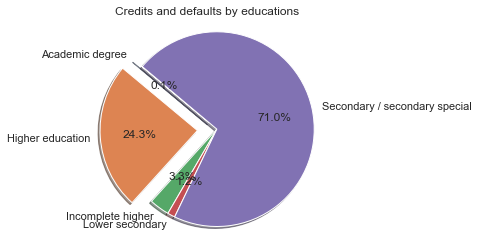

In [103]:
import matplotlib.pyplot as plt

# Data to plot
labels = df_sample['NAME_EDUCATION_TYPE']
sizes = df_sample['count'].to_list()
#colors = sizes
explode = (0.1, 0.2, 0, 0,0)  # explode 1st slice

# Plot
plt.pie(sizes, explode=explode, labels=labels, #colors=colors,
autopct='%1.1f%%', shadow=True, startangle=140)
plt.title("Credits and defaults by educations")
plt.axis('equal')
plt.show()

## Exercitiul 4

Reprezentati printr-un pie chart:
    1. Valoarea medie a venitului total (AMT_INCOME_TOTAL) pe nivel de educatie (NAME_EDUCATION_TYPE)
    2. Rata de default (media lui Target) in functie de statutul familial NAME_FAMILY_STATUS

# Exemplu 5 - Echipa 5

## Donut charts

Cu ajutorul acestui tip de grafic se pot reprezenta proportii de mai multe tipuri simultan.

In [104]:
date_echipa = citire_date_echipa('echipa5')['echipa5']

citire pt  echipa5
1 out of 1: C:\work\UNITBV_DataMining\2020-2021\SEED_ADS\Curs\Echipe\DateProiecte\Echipa5\Kaggle_Sirio_Libanes_ICU_Prediction.xlsx
echipa  echipa5  are  1 dataframe-uri.


In [105]:
date_echipa[0].head()

,PATIENT_VISIT_IDENTIFIER,AGE_ABOVE65,AGE_PERCENTIL,GENDER,DISEASE GROUPING 1,DISEASE GROUPING 2,DISEASE GROUPING 3,DISEASE GROUPING 4,DISEASE GROUPING 5,DISEASE GROUPING 6,...,TEMPERATURE_DIFF,OXYGEN_SATURATION_DIFF,BLOODPRESSURE_DIASTOLIC_DIFF_REL,BLOODPRESSURE_SISTOLIC_DIFF_REL,HEART_RATE_DIFF_REL,RESPIRATORY_RATE_DIFF_REL,TEMPERATURE_DIFF_REL,OXYGEN_SATURATION_DIFF_REL,WINDOW,ICU
0,0,1,60th,0,0.0,0.0,0.0,0.0,1.0,1.0,...,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,0-2,0
1,0,1,60th,0,0.0,0.0,0.0,0.0,1.0,1.0,...,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,2-4,0
2,0,1,60th,0,0.0,0.0,0.0,0.0,1.0,1.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4-6,0
3,0,1,60th,0,0.0,0.0,0.0,0.0,1.0,1.0,...,-1.000000,-1.000000,NaN,NaN,NaN,NaN,-1.000000,-1.000000,6-12,0
4,0,1,60th,0,0.0,0.0,0.0,0.0,1.0,1.0,...,-0.238095,-0.818182,-0.389967,0.407558,-0.230462,0.096774,-0.242282,-0.814433,ABOVE_12,1


In [106]:
date_echipa[0].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1925 entries, 0 to 1924
Columns: 231 entries, PATIENT_VISIT_IDENTIFIER to ICU
dtypes: float64(225), int64(4), object(2)
memory usage: 3.4+ MB


Sa incercam sa vedem proportia de pacienti fereasta de timp sosire (WINDOW) si pe tip de varsta  (AGE_ABOVE65) si care ajung la ATI(ICU)

In [108]:
date_echipa[0].groupby('WINDOW')['PATIENT_VISIT_IDENTIFIER'].agg('count').index

Index(['0-2', '2-4', '4-6', '6-12', 'ABOVE_12'], dtype='object', name='WINDOW')

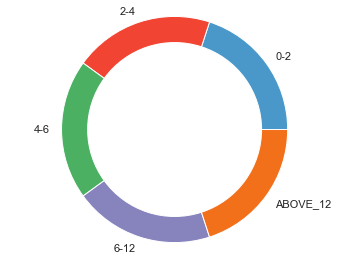

In [111]:
# Libraries
import matplotlib.pyplot as plt
 
# enumaram proprietarii
group_names = date_echipa[0].groupby('WINDOW')['PATIENT_VISIT_IDENTIFIER'].agg('count').index

# numaram proprietarii
group_size=date_echipa[0].groupby('WINDOW')['PATIENT_VISIT_IDENTIFIER'].agg('count').values

subgroup_names=date_echipa[0].groupby(['WINDOW','ICU'])['PATIENT_VISIT_IDENTIFIER'].agg('count').index
subgroup_names=[s[1] for s in subgroup_names]
subgroup_size=date_echipa[0].groupby(['WINDOW','ICU'])['PATIENT_VISIT_IDENTIFIER'].agg('count').values
 
# Creare culori
my_colors=[plt.cm.Blues, plt.cm.Reds, plt.cm.Greens, plt.cm.Purples, plt.cm.Oranges]
my_color_lenghts = date_echipa[0][['WINDOW','ICU']].drop_duplicates().groupby('WINDOW')['ICU'].count()

# Inel exterior
fig, ax = plt.subplots()
ax.axis('equal')
mypie, _ = ax.pie(group_size, radius=1.3, labels=group_names, colors=[c(0.6) for c in my_colors] )
plt.setp( mypie, width=0.3, edgecolor='white')
 
colors = []
for i in range(len(my_colors)):
    
    for j in range(subgroup_size[i]):
        colors.append(my_colors[i](0.6- j * 0.1))
        

plt.margins(0,0)
 
# show it
plt.show()

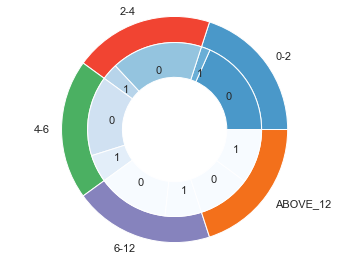

In [112]:
# Libraries
import matplotlib.pyplot as plt
 
# enumaram proprietarii
group_names = date_echipa[0].groupby('WINDOW')['PATIENT_VISIT_IDENTIFIER'].agg('count').index

# numaram proprietarii
group_size=date_echipa[0].groupby('WINDOW')['PATIENT_VISIT_IDENTIFIER'].agg('count').values

subgroup_names=date_echipa[0].groupby(['WINDOW','ICU'])['PATIENT_VISIT_IDENTIFIER'].agg('count').index
subgroup_names=[s[1] for s in subgroup_names]
subgroup_size=date_echipa[0].groupby(['WINDOW','ICU'])['PATIENT_VISIT_IDENTIFIER'].agg('count').values
 
# Creare culori
my_colors=[plt.cm.Blues, plt.cm.Reds, plt.cm.Greens, plt.cm.Purples, plt.cm.Oranges]
my_color_lenghts = date_echipa[0][['WINDOW','ICU']].drop_duplicates().groupby('WINDOW')['ICU'].count()

# Inel exterior
fig, ax = plt.subplots()
ax.axis('equal')
mypie, _ = ax.pie(group_size, radius=1.3, labels=group_names, colors=[c(0.6) for c in my_colors] )
plt.setp( mypie, width=0.3, edgecolor='white')
 
colors = []
for i in range(len(my_colors)):
    
    for j in range(subgroup_size[i]):
        colors.append(my_colors[i](0.6- j * 0.1))
        
# Inel interior
mypie2, _ = ax.pie(subgroup_size, radius=1.3-0.3, labels=subgroup_names, labeldistance=0.7, 
                   colors=colors)
plt.setp( mypie2, width=0.4, edgecolor='white')
plt.margins(0,0)
 
# show it
plt.show()

In [ ]:
citire_date_echipa('echipa5')['echipa5'][0].columns

# Exercitiul 5

1. Donut chart cu distributia pe AGE_PERCENTIL si GENDER (Years of Credit History)


# Exemplul 6 - Echipa 6

## Boxplot

Grafic care prezinta distributia unei variabile folosind precentile. Util pentru compararea unor distributii si a evolutiei in timp, sau pentru comparare alaturata a unor variabile continue asemanatoare

In [114]:
date_echipa = citire_date_echipa('echipa6')['echipa6']


citire pt  echipa6
1 out of 1: C:\work\UNITBV_DataMining\2020-2021\SEED_ADS\Curs\Echipe\DateProiecte\Echipa6\database.sqlite
                name
0            Country
1             League
2              Match
3             Player
4  Player_Attributes
5               Team
6    Team_Attributes
7    sqlite_sequence
extragere date tabel Country (0 out of 8)
extragere date tabel League (1 out of 8)
extragere date tabel Match (2 out of 8)
extragere date tabel Player (3 out of 8)
extragere date tabel Player_Attributes (4 out of 8)
extragere date tabel Team (5 out of 8)
extragere date tabel Team_Attributes (6 out of 8)
extragere date tabel sqlite_sequence (7 out of 8)
eroare la citire fisierelor pt  echipa6 fisier  C:\work\UNITBV_DataMining\2020-2021\SEED_ADS\Curs\Echipe\DateProiecte\Echipa6\database.sqlite
echipa  echipa6  are  8 dataframe-uri.


Index(['id', 'country_id', 'name'], dtype='object')

In [116]:
date_echipa[4].columns

Index(['id', 'player_fifa_api_id', 'player_api_id', 'date', 'overall_rating',
       'potential', 'preferred_foot', 'attacking_work_rate',
       'defensive_work_rate', 'crossing', 'finishing', 'heading_accuracy',
       'short_passing', 'volleys', 'dribbling', 'curve', 'free_kick_accuracy',
       'long_passing', 'ball_control', 'acceleration', 'sprint_speed',
       'agility', 'reactions', 'balance', 'shot_power', 'jumping', 'stamina',
       'strength', 'long_shots', 'aggression', 'interceptions', 'positioning',
       'vision', 'penalties', 'marking', 'standing_tackle', 'sliding_tackle',
       'gk_diving', 'gk_handling', 'gk_kicking', 'gk_positioning',
       'gk_reflexes'],
      dtype='object')

In [118]:
for c in date_echipa[4].columns:
    print(c + ': {0}'.format(date_echipa[4][c].nunique()) )

id: 183978
player_fifa_api_id: 11062
player_api_id: 11060
date: 197
overall_rating: 61
potential: 56
preferred_foot: 2
attacking_work_rate: 8
defensive_work_rate: 19
crossing: 95
finishing: 97
heading_accuracy: 96
short_passing: 95
volleys: 93
dribbling: 97
curve: 92
free_kick_accuracy: 97
long_passing: 95
ball_control: 93
acceleration: 86
sprint_speed: 85
agility: 81
reactions: 78
balance: 81
shot_power: 96
jumping: 79
stamina: 84
strength: 82
long_shots: 96
aggression: 91
interceptions: 96
positioning: 95
vision: 97
penalties: 94
marking: 95
standing_tackle: 95
sliding_tackle: 94
gk_diving: 93
gk_handling: 90
gk_kicking: 97
gk_positioning: 94
gk_reflexes: 92


In [117]:
date_echipa[4].overall_rating.drop_duplicates()

0         67.0
2         62.0
3         61.0
5         74.0
7         73.0
          ... 
57833     33.0
65309     36.0
66212     37.0
76551     35.0
102482    94.0
Name: overall_rating, Length: 62, dtype: float64

As vrea sa vad distributia ratingului jucatorilor in boxplot. Apoi as vrea sa vad comparate boxloturi pe preferred_foot in acelasi grafic ca sa pot compara jucatorii de picior drept cu cei de picior stang:

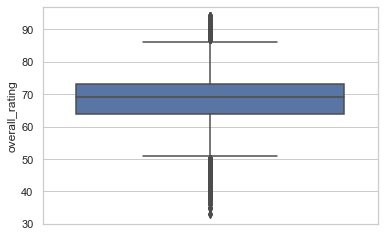

In [119]:
ax = sns.boxplot(y="overall_rating",data=date_echipa[4])

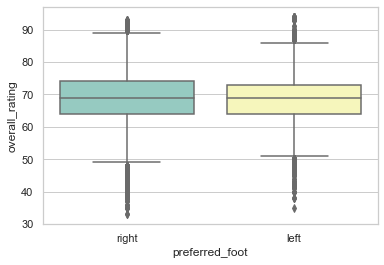

In [120]:
ax = sns.boxplot(x="preferred_foot", y="overall_rating", data=date_echipa[4], palette="Set3")

Sa vedem distributiile ratingului in functie de contributia in atac, pe grupe de picior-preferat:

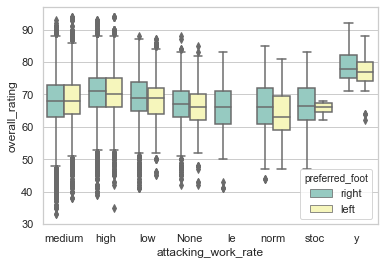

In [121]:
ax = sns.boxplot(x="attacking_work_rate", y="overall_rating", hue="preferred_foot",data=date_echipa[4], palette="Set3")

# Exercitiul 6

1. Boxplot cu distributia overall_rating pentru jucatorii cu rating peste 50, in functie de piciorul preferat?

2. Care sunt echipele cu cel mai mare rating mediu? 
Boxplot cu distributia ratingului jucatorilor la primele 10 echipe in functie de ratingul total (trebuie sa faceti merge cu echipa la care joaca jucatorul) 

In [ ]:
# codul vostru aici

# Exemplul 7 - echipa 7

## Scatterplot

In [131]:
date_echipa = citire_date_echipa('echipa4')['echipa4']


citire pt  echipa4
1 out of 3: C:\work\UNITBV_DataMining\2020-2021\SEED_ADS\Curs\Echipe\DateProiecte\Echipa4\application_data.csv
2 out of 3: C:\work\UNITBV_DataMining\2020-2021\SEED_ADS\Curs\Echipe\DateProiecte\Echipa4\columns_description.csv
3 out of 3: C:\work\UNITBV_DataMining\2020-2021\SEED_ADS\Curs\Echipe\DateProiecte\Echipa4\previous_application.csv
echipa  echipa4  are  3 dataframe-uri.


In [137]:
date_echipa[0][date_echipa[0].columns[0:30]].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Data columns (total 30 columns):
SK_ID_CURR                    307511 non-null int64
TARGET                        307511 non-null int64
NAME_CONTRACT_TYPE            307511 non-null object
CODE_GENDER                   307511 non-null object
FLAG_OWN_CAR                  307511 non-null object
FLAG_OWN_REALTY               307511 non-null object
CNT_CHILDREN                  307511 non-null int64
AMT_INCOME_TOTAL              307511 non-null float64
AMT_CREDIT                    307511 non-null float64
AMT_ANNUITY                   307499 non-null float64
AMT_GOODS_PRICE               307233 non-null float64
NAME_TYPE_SUITE               306219 non-null object
NAME_INCOME_TYPE              307511 non-null object
NAME_EDUCATION_TYPE           307511 non-null object
NAME_FAMILY_STATUS            307511 non-null object
NAME_HOUSING_TYPE             307511 non-null object
REGION_POPULATION_RELATIVE    307511 non

In [141]:
date_echipa[0].TARGET.unique()

array([1, 0], dtype=int64)

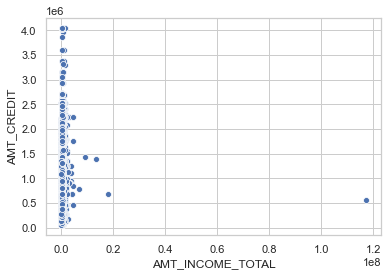

In [138]:
ax = sns.scatterplot(x="AMT_INCOME_TOTAL", y="AMT_CREDIT", data=date_echipa[0])


In [140]:
import plotly.express as px
fig = px.scatter(date_echipa[0],x='AMT_INCOME_TOTAL', y='AMT_CREDIT',color = 'TARGET')
fig.show()

# Exercitiul 7

Scatter plot cu imprumutul acordat (AMT_CREDIT ) si AMT_ANNUITY colorate dupa GENDER. 

Scatter plot cu imprumutul acordat (AMT_CREDIT ) si AMT_ANNUITY colorate dupa TARGET.

In [ ]:
# Bonus plots

In [ ]:
## time series animation
## circular graphs https://mne.tools/stable/auto_examples/connectivity/plot_mne_inverse_label_connectivity.html
## word frequency

# Bonus plot - word count

Sunt multe librarii care fac asta. Vom folosi WordCloud care nu vine cu Anaconda si o vom instala ad-hoc

In [203]:
!pip install wordcloud

Scopul este sa obtinem o ilustarare grafica a asiguratorilor in functie de numarul de cereri de despagubire:

(-0.5, 399.5, 199.5, -0.5)

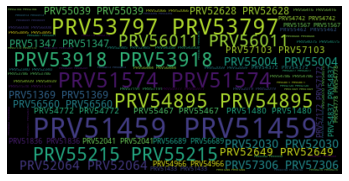

In [204]:
from wordcloud import WordCloud

# numaram cazurile pe asigurator
word_freq = date_echipa[6].groupby('Provider')['ClaimID'].count()
text = " ".join([(k + " ")*v for k,v in word_freq.items()])

# Generare de word cloud image
wordcloud = WordCloud().generate(text)


# Display imagine generata:
# the matplotlib way:
import matplotlib.pyplot as plt
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")



# Corelatii intre atribute numerice



### Coeficientul de corelatie pentru doua serii numerice

### Matricea de corelatie

# Exemplul 8 - Echipa 9

In [ ]:
date_echipa = citire_date_echipa('echipa9')['echipa9']

In [ ]:
date_echipa[1].dtypes

In [ ]:
corr = date_echipa[1].avg_glucose_level.values,date_echipa[1].bmi.values)

In [ ]:
ax = sns.scatterplot(x='avg_glucose_level',y='bmi',data=date_echipa[1])
#ax.set_title()

### Vizualizarea matricei de corelatie

# Exemplul 9

### Matricea de corelatie cu subgrupuri si scatter plot

# Exemplul 10

## Codificarea atributelor categoriale - reguli de buna practica

### Atribute binare
### Ordine explicita
### Ordine bazata pe agregarea unei variabile de interes
### In absenta oricarei ordini - One-Hot-Encoding

## O metoda de reducere a dimensiunii: Principal Component Analysis

### Componenetele principale

### Reconstructia partiala si eroarea de reconstructie

### Matricea de proiectie si utilizarea in practica: exemplul SPC